In [1]:
# Importing TensorFlow and Keras for deep learning
import tensorflow as tf  # TensorFlow framework for machine learning
import keras  # Keras API for building neural networks
# Importing essential numerical and data handling libraries
import numpy as np  # Numerical computing library for arrays and mathematical operations
import pandas as pd  # Data manipulation and analysis library, useful for handling datasets
# Importing visualization libraries
import matplotlib as mpl  # Base library for visualizations
import matplotlib.pyplot as plt  # Pyplot for creating plots and graphs
import matplotlib.cm as cm  # Colormap functions for visualizations
# Importing utility libraries
import itertools  # Helps with iterating through combinations and permutations
import pathlib  # Provides an object-oriented approach for handling file paths
import PIL  # Python Imaging Library (Pillow) for working with images
import time  # Provides time-related functions (e.g., measuring execution time)
import datetime  # Handling dates and timestamps
import random  # Used for generating random numbers and shuffling datasets
import shutil  # File operations like copying and deleting files
import seaborn as sns  # Statistical visualization library (e.g., heatmaps, box plots)
# Importing TensorFlow's image preprocessing functions
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
# Importing a pre-trained CNN model for transfer learning
from tensorflow.keras.applications import ResNet50V2  # ResNet50V2 for image classification tasks
from tensorflow.keras.applications.resnet50 import preprocess_input  # Preprocesses input images for ResNet50
# Importing modules for building neural networks
from tensorflow.keras.models import Sequential, Model
# Sequential - Simple stack of layers for building a neural network
# Model - More flexible API for building complex architectures
# Importing different layers for the CNN
from tensorflow.keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D, Layer, Flatten
from tensorflow.keras.layers import Activation, Dropout, Dense
# Activation - Applies an activation function (e.g., ReLU, Softmax)
# Importing optimizers and callbacks for model training
from tensorflow.keras.optimizers import Adam  # Adam optimizer for adaptive learning rates
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau, Callback
#create cnn model of the dataset
from tensorflow.keras import layers
# Importing performance evaluation metrics
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report  # Generates a detailed classification report (precision, recall, F1-score)
from sklearn.metrics import confusion_matrix  # Creates a confusion matrix to evaluate model performance


In [2]:
# Mount google drive and the change working directory
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
import os
dataset_path = '/content/drive/MyDrive/data/bird_images_dataset'
with_background_path = os.path.join(dataset_path, "withBackground")
without_background_path = os.path.join(dataset_path, "withoutBackground")
bird_cvs_path = '/content/drive/MyDrive/data/bird_images_dataset/birds.csv'

In [4]:
birds_df = pd.read_csv(bird_cvs_path)
print(birds_df)

      class id                               filepaths          label  \
0            0     withBackground/House_Sparrow/(1)jpg  House_Sparrow   
1            0     withBackground/House_Sparrow/(2)jpg  House_Sparrow   
2            0     withBackground/House_Sparrow/(3)jpg  House_Sparrow   
3            0     withBackground/House_Sparrow/(4)jpg  House_Sparrow   
4            0     withBackground/House_Sparrow/(5)jpg  House_Sparrow   
...        ...                                     ...            ...   
5683        19  withoutBackground/Song_Thrush/(146)jpg    Song_Thrush   
5684        19  withoutBackground/Song_Thrush/(147)jpg    Song_Thrush   
5685        19  withoutBackground/Song_Thrush/(148)jpg    Song_Thrush   
5686        19  withoutBackground/Song_Thrush/(149)jpg    Song_Thrush   
5687        19  withoutBackground/Song_Thrush/(150)jpg    Song_Thrush   

        scientific name  Big Garden Bird Watch '22 Rank BoCC5 Status  \
0     Passer domesticus                            

<ipython-input-5-b0346792c25c>:11: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap('viridis', num_classes)


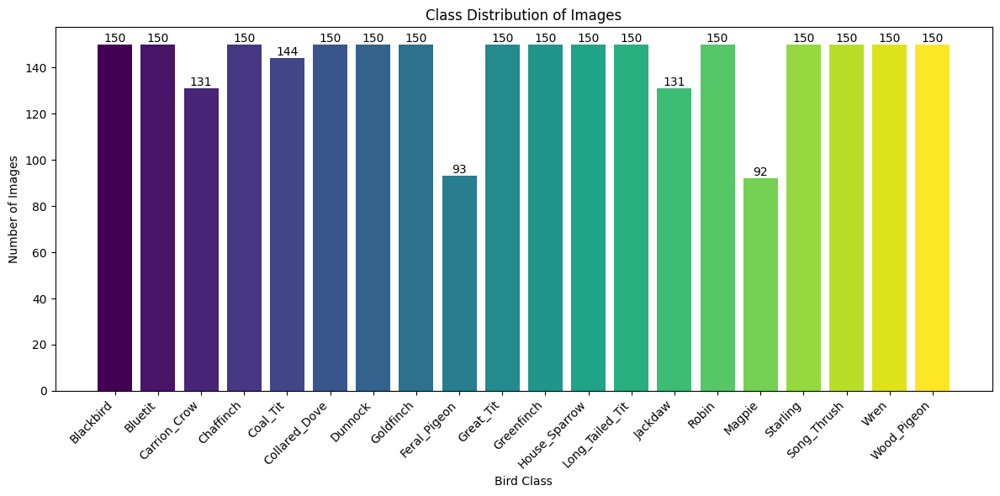

In [5]:
# Dataset path
with_background_path = '/content/drive/MyDrive/data/bird_images_dataset/withBackground'

# Get class names and image counts
bird_classes = os.listdir(with_background_path)
image_counts = [len(os.listdir(os.path.join(with_background_path, bird_class)))
                for bird_class in bird_classes]

# Generate distinct colors for each class
num_classes = len(bird_classes)
colors = plt.cm.get_cmap('viridis', num_classes)
colors = [colors(i) for i in range(num_classes)]

# Create the bar chart
plt.figure(figsize=(12, 6))
bars = plt.bar(bird_classes, image_counts, color=colors)

# Annotate each bar with the image count
for bar, count in zip(bars, image_counts):
    # Get the center of each bar on x-axis and the top on y-axis
    plt.text(bar.get_x() + bar.get_width()/2, bar.get_height(),
             str(count), ha='center', va='bottom', fontsize=10)

plt.title('Class Distribution of Images')
plt.xlabel('Bird Class')
plt.ylabel('Number of Images')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


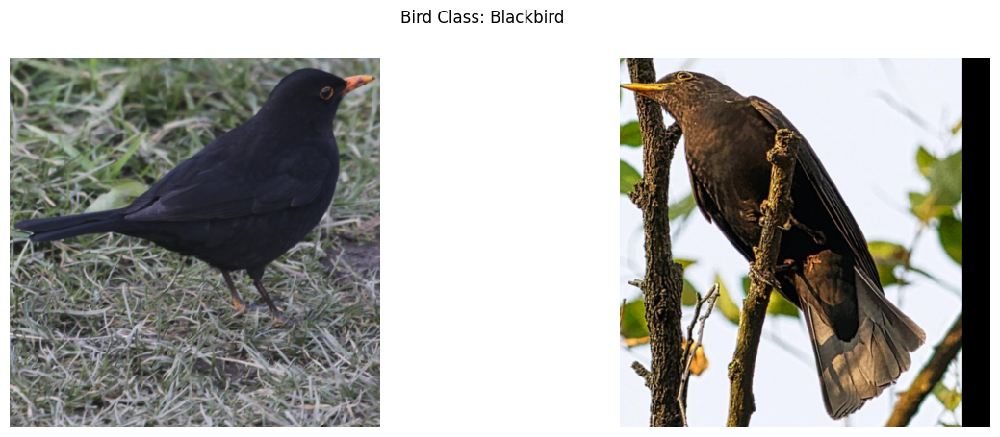

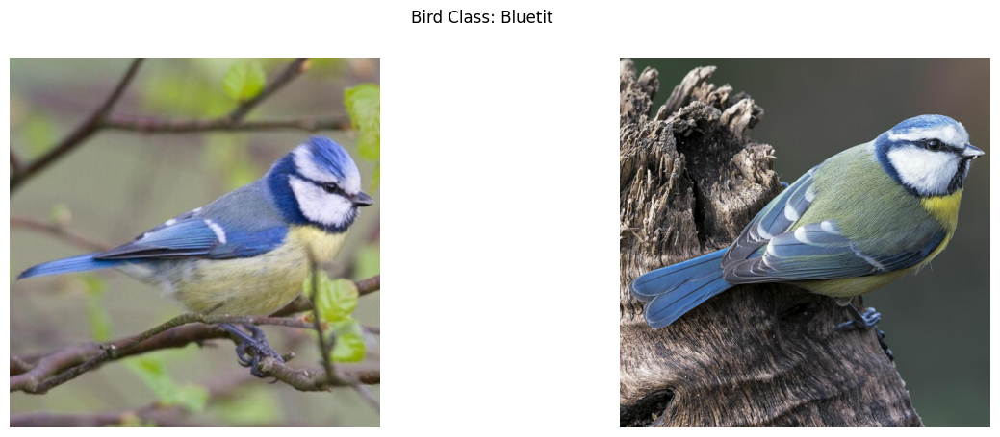

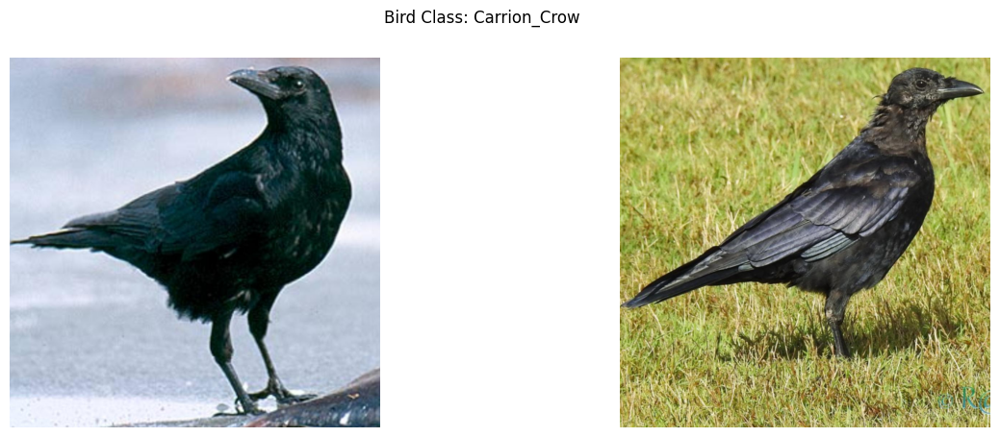

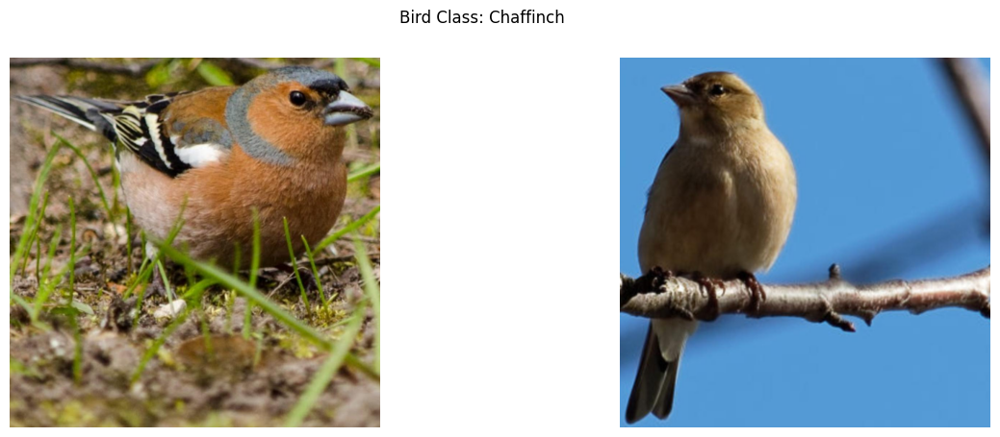

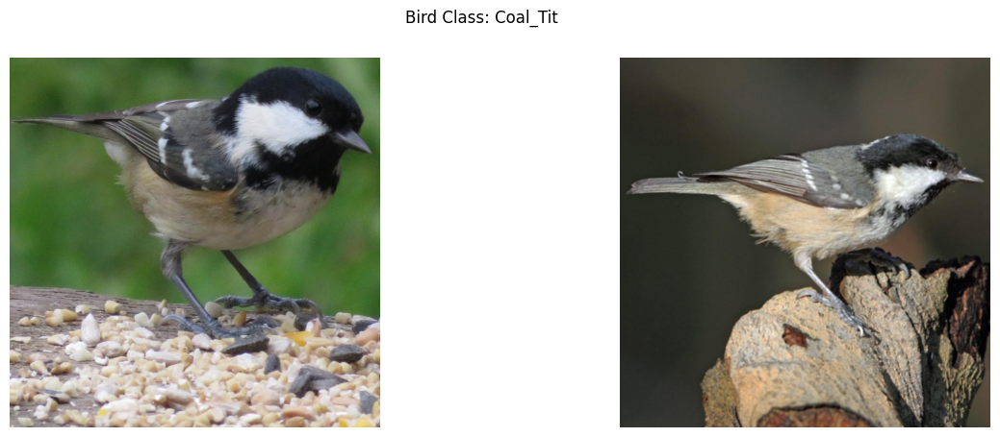

...

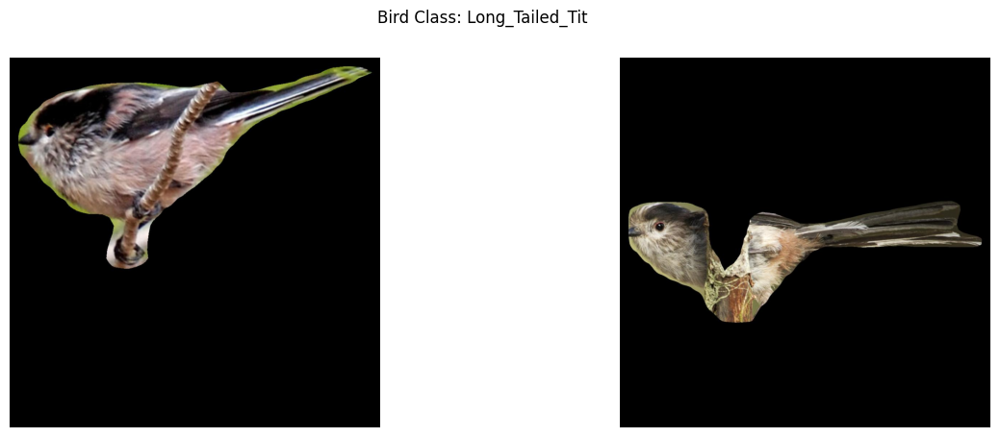

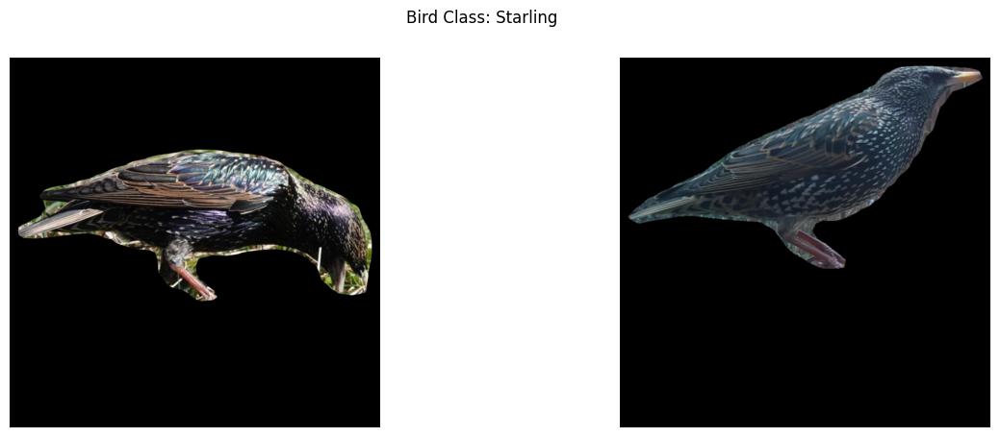

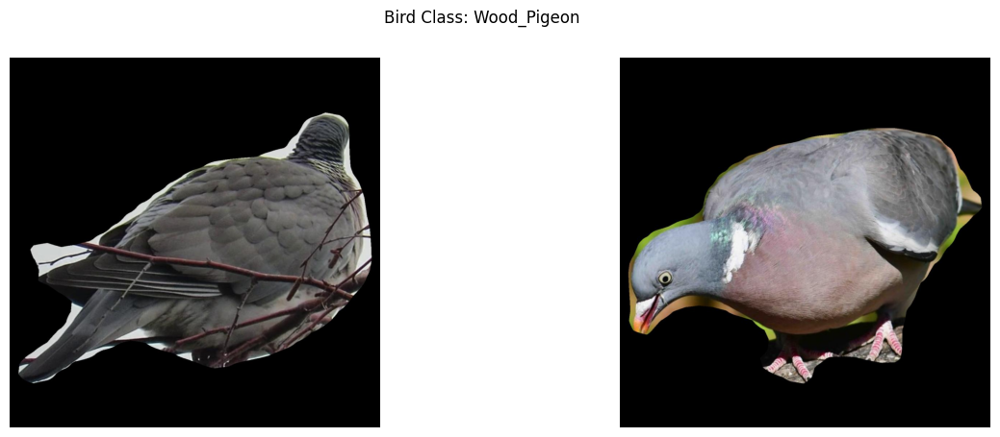

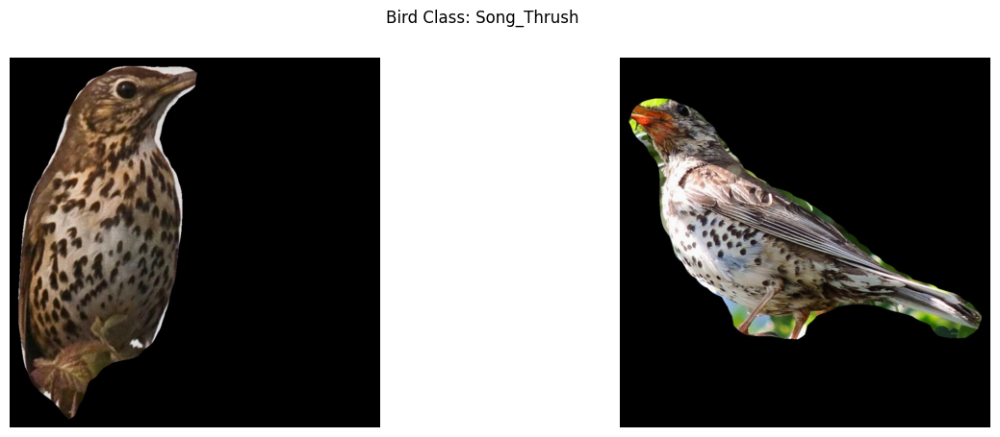

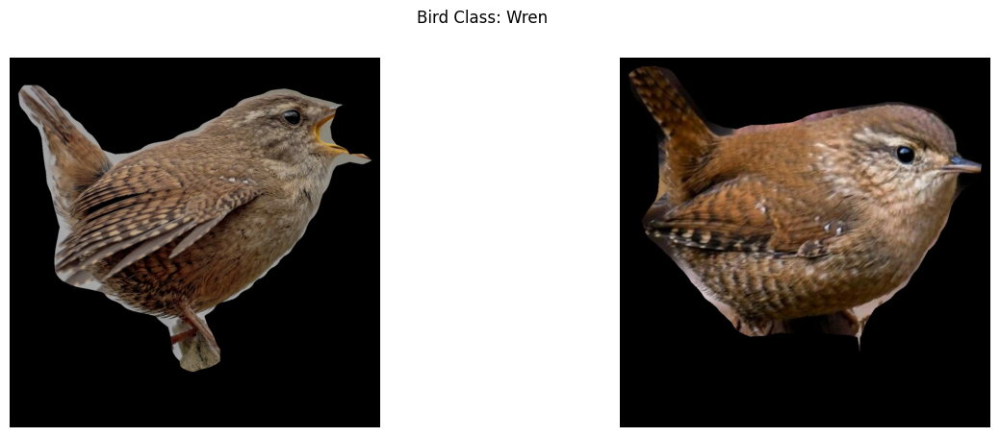

In [6]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
import random

def display_images(folder_path, num_images_per_class=2):

    bird_classes = os.listdir(folder_path)

    for bird_class in bird_classes:
        class_folder = os.path.join(folder_path, bird_class)
        image_files = os.listdir(class_folder)

        # Randomly select images to display
        selected_images = random.sample(image_files, min(num_images_per_class, len(image_files)))

        # Display images
        fig, axes = plt.subplots(1, len(selected_images), figsize=(15, 5))
        fig.suptitle(f"Bird Class: {bird_class}")

        for i, image_file in enumerate(selected_images):
            image_path = os.path.join(class_folder, image_file)
            image = mpimg.imread(image_path)

            axes[i].imshow(image)
            axes[i].axis('off')  # Turn off axis labels

        plt.show()

# Display images from both folders
display_images(with_background_path)
display_images(without_background_path)

In [7]:
dirs = os.listdir('/content/drive/MyDrive/data/bird_images_dataset/withBackground')
count = 0  # Initialize count before the loop
for dir in dirs:
  files = list(os.listdir('/content/drive/MyDrive/data/bird_images_dataset/withBackground/'+dir))
  print(dir +'folder has  ' + str(len(files)) + ' images') # Changed dirs to dir
  count = count + len(files)
print(count)

Blackbirdfolder has  150 images
Bluetitfolder has  150 images
Carrion_Crowfolder has  131 images
Chaffinchfolder has  150 images
Coal_Titfolder has  144 images
Collared_Dovefolder has  150 images
Dunnockfolder has  150 images
Goldfinchfolder has  150 images
Feral_Pigeonfolder has  93 images
Great_Titfolder has  150 images
Greenfinchfolder has  150 images
House_Sparrowfolder has  150 images
Long_Tailed_Titfolder has  150 images
Jackdawfolder has  131 images
Robinfolder has  150 images
Magpiefolder has  92 images
Starlingfolder has  150 images
Song_Thrushfolder has  150 images
Wrenfolder has  150 images
Wood_Pigeonfolder has  150 images
2841


In [8]:
import os
from PIL import Image

def check_image_sizes(folder_path, target_size=(1024, 1024)):
  all_same_size = True
  for filename in os.listdir(folder_path):
    if filename.endswith(('.jpg', '.jpeg', '.png')):
      image_path = os.path.join(folder_path, filename)
      try:
        with Image.open(image_path) as image:
          if image.size != target_size:
            print(f"Image {filename} has size {image.size}, not {target_size}")
            all_same_size = False
      except IOError:
        print(f"Error opening image: {filename}")
        all_same_size = False
  return all_same_size

# Example usage:
with_background_path = '/content/drive/MyDrive/data/bird_images_dataset/withBackground'
if check_image_sizes(with_background_path):
  print("All images have the target size.")
else:
  print("Some images have different sizes.")

All images have the target size.


In [9]:
import os
from PIL import Image

def check_corrupted_images(base_path):
    corrupted_images = []
    dirs = os.listdir(base_path)

    for dir_name in dirs:
        dir_path = os.path.join(base_path, dir_name)
        if os.path.isdir(dir_path):
            for img_name in os.listdir(dir_path):
                img_path = os.path.join(dir_path, img_name)
                try:
                    with Image.open(img_path) as img:
                        img.verify()
                except (IOError, SyntaxError) as e:
                    print(f'Corrupted image detected: {img_path}')
                    corrupted_images.append(img_path)

    print(f'Total corrupted images found: {len(corrupted_images)}')
    return corrupted_images
dataset_path = '/content/drive/MyDrive/data/bird_images_dataset/withBackground'
corrupted = check_corrupted_images(dataset_path)


Total corrupted images found: 0


In [10]:
#from sklearn.model_selection import train_test_split

# Assume X is your feature data and y is your target variable data
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [11]:
base_dir = '/content/drive/MyDrive/data/bird_images_dataset/withBackground/'
img_size = 224
batch_size = 64


In [12]:
train_ds = tf.keras.utils.image_dataset_from_directory(
    base_dir,
    validation_split=0.2,
    subset="training",
    seed=123,
    image_size=(img_size, img_size),
    batch_size=batch_size
)

val_ds = tf.keras.utils.image_dataset_from_directory(
    base_dir,
    validation_split=0.2,
    subset="validation",
    seed=123,
    image_size=(img_size, img_size),
    batch_size=batch_size
)

Found 2841 files belonging to 20 classes.
Using 2273 files for training.
Found 2841 files belonging to 20 classes.
Using 568 files for validation.


In [13]:
bird_names = train_ds.class_names
print(bird_names)


['Blackbird', 'Bluetit', 'Carrion_Crow', 'Chaffinch', 'Coal_Tit', 'Collared_Dove', 'Dunnock', 'Feral_Pigeon', 'Goldfinch', 'Great_Tit', 'Greenfinch', 'House_Sparrow', 'Jackdaw', 'Long_Tailed_Tit', 'Magpie', 'Robin', 'Song_Thrush', 'Starling', 'Wood_Pigeon', 'Wren']


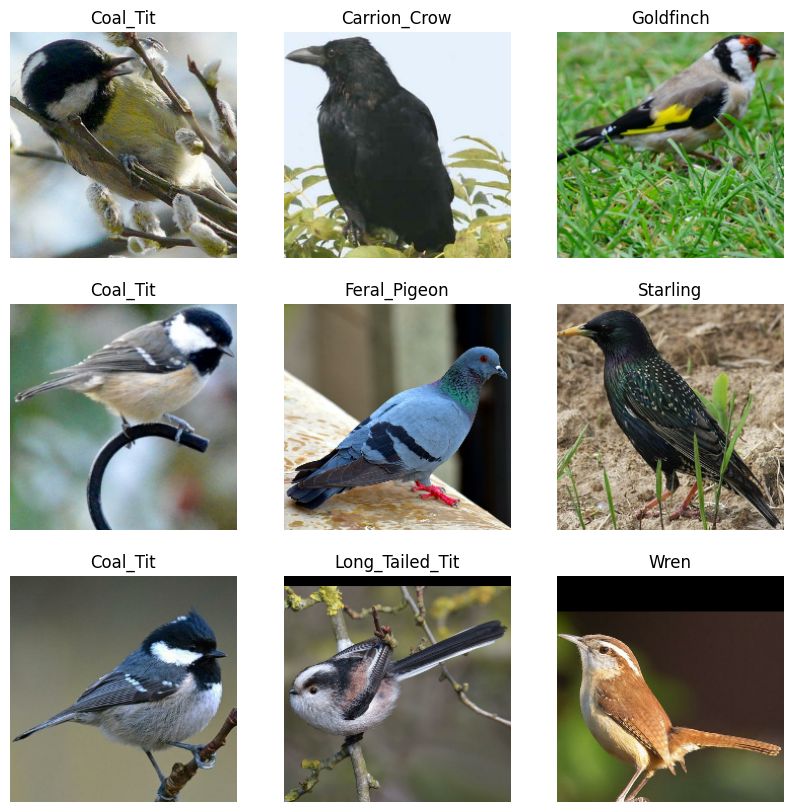

In [14]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    ax.imshow(images[i].numpy().astype("uint8"))
    ax.set_title(bird_names[labels[i]])
    ax.axis("off")

plt.show()

In [15]:
AUTOTUNE = tf.data.AUTOTUNE

train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)
#

In [ ]:
#Data Augmentation
data_augmentation = tf.keras.Sequential([
  tf.keras.layers.RandomFlip('horizontal', input_shape = (img_size,img_size,3)),
  tf.keras.layers.RandomRotation(0.3),  # Increased rotation
  tf.keras.layers.RandomZoom(0.2),  # Increased zoom
  tf.keras.layers.RandomShear(0.)  # Increased contrast
])

/usr/local/lib/python3.11/dist-packages/keras/src/layers/preprocessing/tf_data_layer.py:19: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


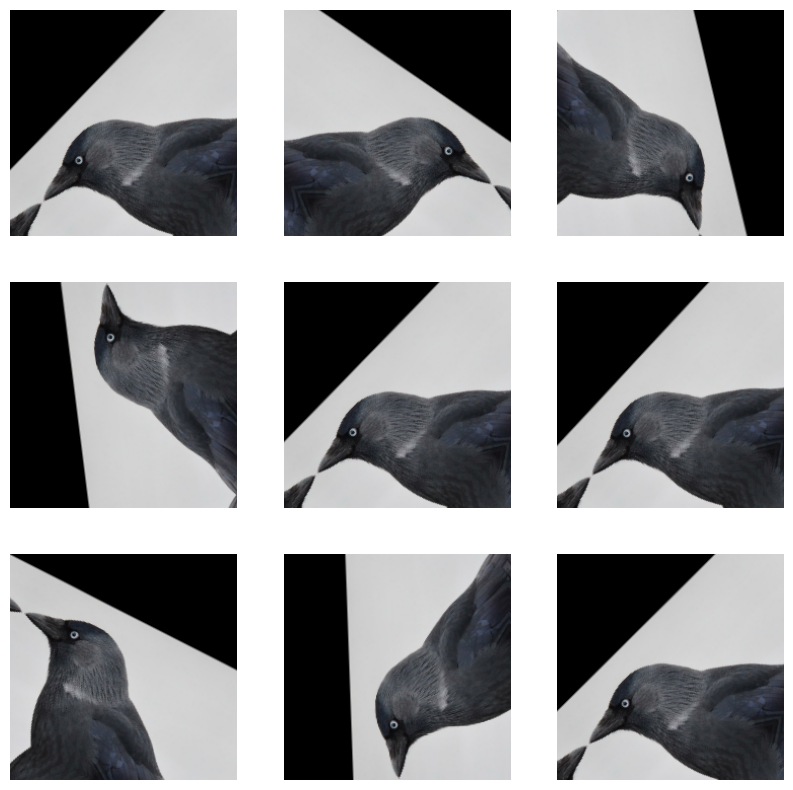

In [17]:
plt.figure(figsize=(10, 10)) # Adjust the figure size as needed
for images, _ in train_ds.take(1):  # Ignore labels for this visualization
  for i in range(9): # loops for 9 images
    # Apply augmentation to each image individually within the batch
    # Fix: Add a new axis to the image to simulate a batch of one image
    augmented_image = data_augmentation(images[1][None, ...])
    ax = plt.subplot(3, 3, i + 1)
    ax.imshow(augmented_image[0].numpy().astype("uint8"))  # Access the first image from the augmented batch
    ax.axis("off")  # Turn off axis for cleaner visualization

plt.show()

In [18]:
#create cnn model of the dataset

# Create the CNN model
model = Sequential([
    data_augmentation,  # Apply data augmentation to the input images
    layers.Rescaling(1./255, input_shape=(img_size, img_size, 3)),  # Rescale pixel values to [0, 1] and define input shape
    Conv2D(16, 3, padding='same', activation='relu'),  # First convolutional layer with 16 filters, kernel size 3x3, 'same' padding, and ReLU activation
    MaxPooling2D(),  # Max pooling layer to downsample feature maps
    Conv2D(32, 3, padding='same', activation='relu'),  # Second convolutional layer with 32 filters
    MaxPooling2D(),  # Max pooling layer
    Conv2D(64, 3, padding='same', activation='relu'),  # Third convolutional layer with 64 filters
    MaxPooling2D(),  # Max pooling layer
    Dropout(0.2),  # Dropout layer with a rate of 0.2 to prevent overfitting
    Flatten(),  # Flatten the output from convolutional layers into a 1D vector
    Dense(128, activation='relu'),  # Fully connected layer with 128 units and ReLU activation
    Dense(len(bird_names), activation='softmax')  # Output layer with softmax activation for multi-class classification
])

model.compile(optimizer='adam',  # Optimizer: Adam (adaptive moment estimation)
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),  # Loss function: SparseCategoricalCrossentropy (for multi-class classification)
              metrics=['accuracy'])  # Metrics: Accuracy (to evaluate model performance)



In [19]:
model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ sequential (Sequential)         │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ rescaling (Rescaling)           │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 224, 224, 16)   │           448 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 112, 112, 16)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 112, 112, 32)   │         4,640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 56, 56, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 56, 56, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 28, 28, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 28, 28, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 50176)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │     6,422,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 20)             │         2,580 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,448,820 (24.60 MB)

 Trainable params: 6,448,820 (24.60 MB)

 Non-trainable params: 0 (0.00 B)

In [20]:

#training the model

history = model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=65
)

Epoch 1/65


/usr/local/lib/python3.11/dist-packages/keras/src/backend/tensorflow/nn.py:708: UserWarning: "`sparse_categorical_crossentropy` received `from_logits=True`, but the `output` argument was produced by a Softmax activation and thus does not represent logits. Was this intended?
  output, from_logits = _get_logits(


36/36 ━━━━━━━━━━━━━━━━━━━━ 164s 5s/step - accuracy: 0.0550 - loss: 3.2683 - val_accuracy: 0.0739 - val_loss: 2.9629
Epoch 2/65
36/36 ━━━━━━━━━━━━━━━━━━━━ 194s 4s/step - accuracy: 0.0953 - loss: 2.9213 - val_accuracy: 0.1444 - val_loss: 2.7252
Epoch 3/65
36/36 ━━━━━━━━━━━━━━━━━━━━ 199s 4s/step - accuracy: 0.1655 - loss: 2.6665 - val_accuracy: 0.2218 - val_loss: 2.4078
Epoch 4/65
36/36 ━━━━━━━━━━━━━━━━━━━━ 150s 4s/step - accuracy: 0.2396 - loss: 2.4072 - val_accuracy: 0.2518 - val_loss: 2.2912
Epoch 5/65
36/36 ━━━━━━━━━━━━━━━━━━━━ 159s 4s/step - accuracy: 0.2647 - loss: 2.2969 - val_accuracy: 0.2887 - val_loss: 2.1616
Epoch 6/65
36/36 ━━━━━━━━━━━━━━━━━━━━ 164s 5s/step - accuracy: 0.3358 - loss: 2.1207 - val_accuracy: 0.3310 - val_loss: 2.1358
Epoch 7/65
36/36 ━━━━━━━━━━━━━━━━━━━━ 188s 4s/step - accuracy: 0.3663 - loss: 2.0147 - val_accuracy: 0.3662 - val_loss: 1.9625
Epoch 8/65
36/36 ━━━━━━━━━━━━━━━━━━━━ 148s 4s/step - accuracy: 0.4116 - loss: 1.9330 - val_accuracy: 0.3680 - val_loss: 2.

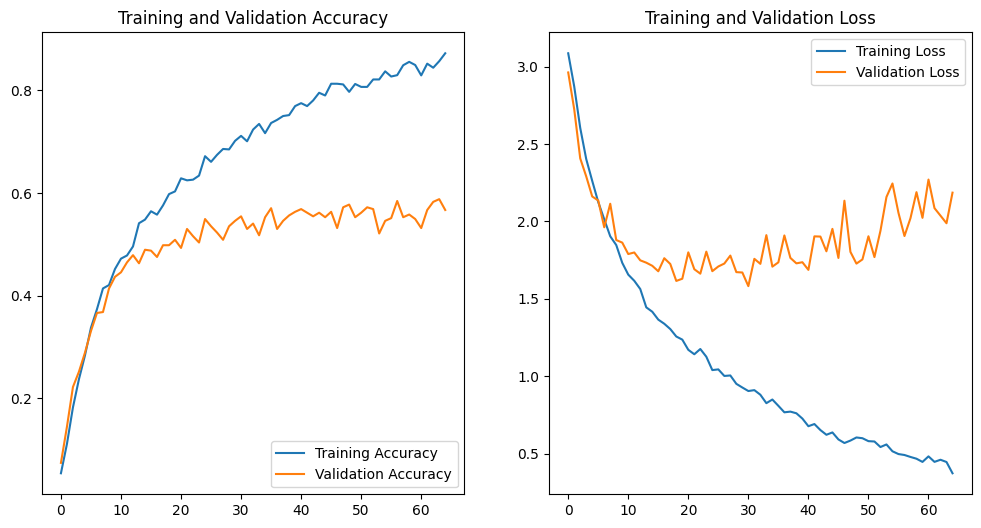

In [21]:


# getting the model history and setting the values of the model
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(len(acc))  # Get the number of epochs

plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

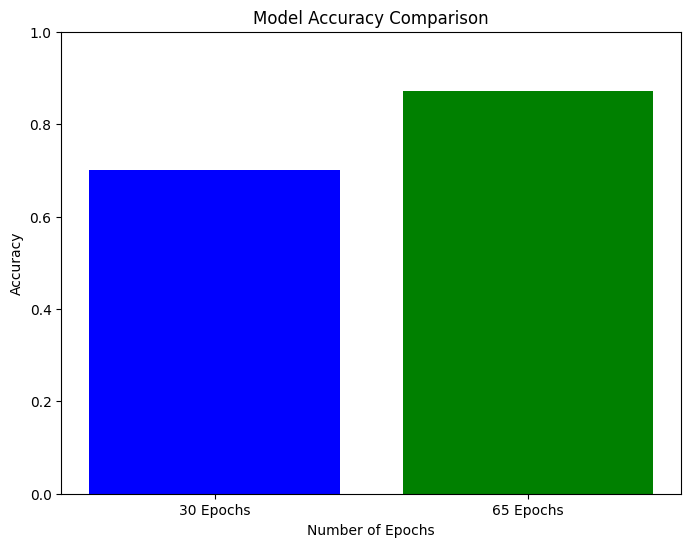

In [22]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

# Get accuracy at 30 and 65 epochs
accuracy_30_epochs = acc[29]  # Accuracy at the end of the 30th epoch (index 29)
accuracy_65_epochs = acc[64]  # Accuracy at the end of the 65th epoch (index 64)

# Create the bar chart
epochs = ['30 Epochs', '65 Epochs']
accuracies = [accuracy_30_epochs, accuracy_65_epochs]

plt.figure(figsize=(8, 6))
plt.bar(epochs, accuracies, color=['blue', 'green'])
plt.title('Model Accuracy Comparison')
plt.ylabel('Accuracy')
plt.xlabel('Number of Epochs')
plt.ylim(0, 1)  # Set y-axis limits to 0-1 for accuracy

plt.show()

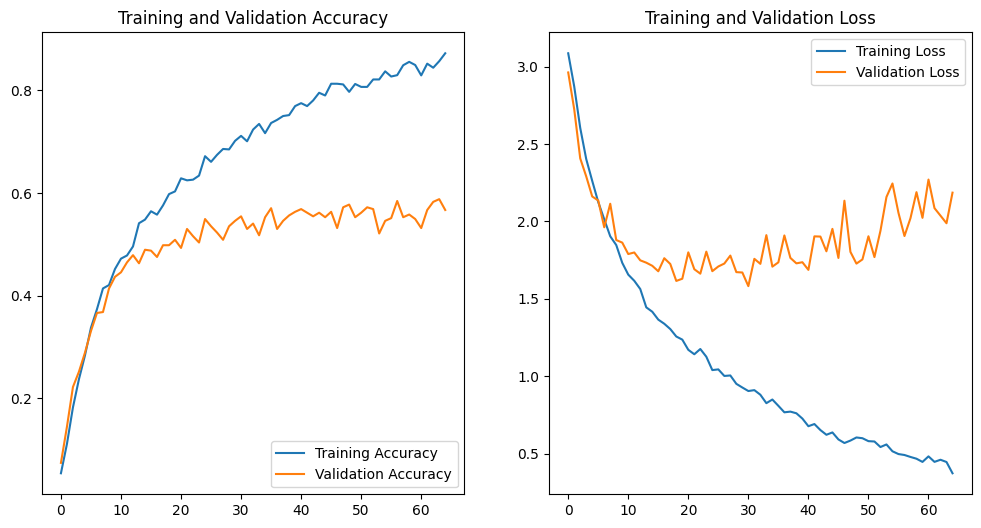

In [23]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import confusion_matrix

acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(65)

plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

9/9 ━━━━━━━━━━━━━━━━━━━━ 11s 1s/step


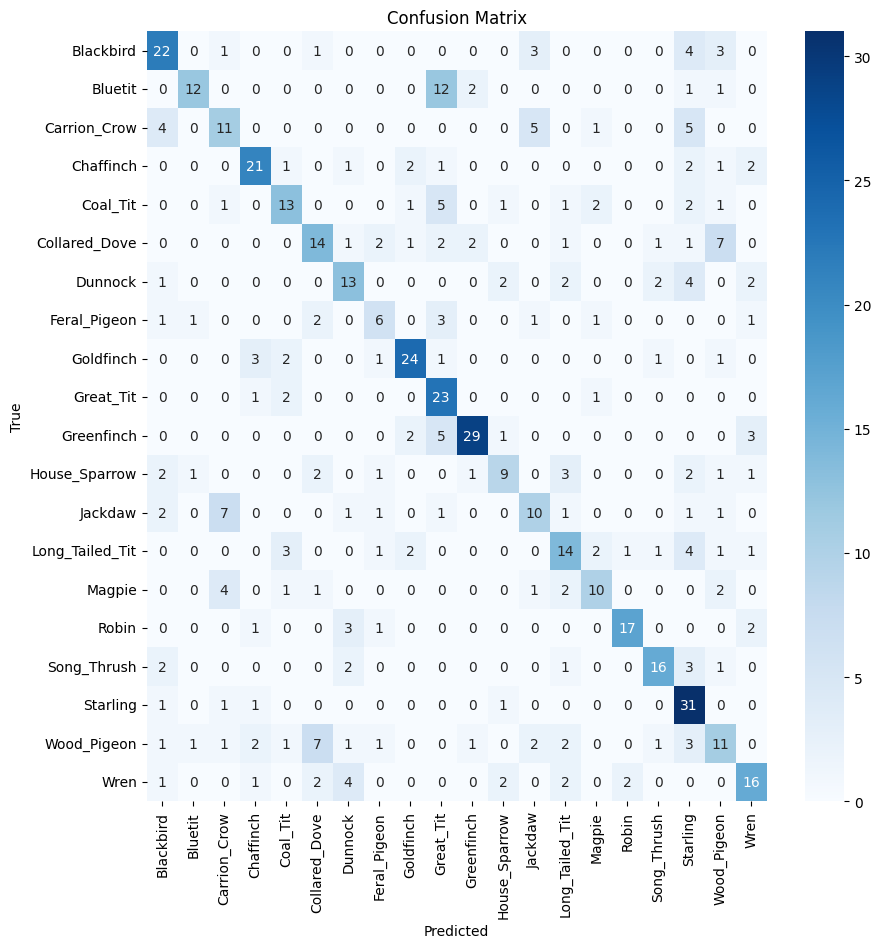

In [24]:
# Confusion Matrix
# Get predictions for the validation dataset
y_pred = model.predict(val_ds)
y_pred = np.argmax(y_pred, axis=1)  # Convert predictions to class labels

# Get true labels for the validation dataset
y_true = []
for images, labels in val_ds:
    y_true.extend(labels.numpy())

# Create the confusion matrix
cm = confusion_matrix(y_true, y_pred)

# Plot the confusion matrix
plt.figure(figsize=(10, 10))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=bird_names, yticklabels=bird_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

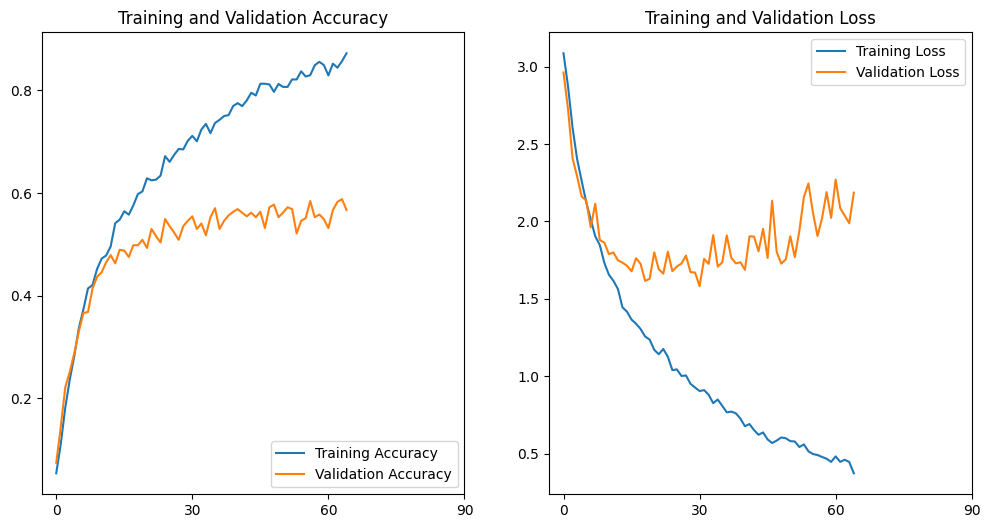

In [25]:
epochs_ticks = [0, 30, 60, 90]

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')
plt.xticks(epochs_ticks)  # Set the x-axis ticks

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xticks(epochs_ticks)  # Set the x-axis ticks

plt.show()

In [26]:
# Get predictions for the validation dataset (same as for confusion matrix)
y_pred = model.predict(val_ds)
y_pred = np.argmax(y_pred, axis=1)  # Convert predictions to class labels

# Get true labels for the validation dataset (same as for confusion matrix)
y_true = []
for images, labels in val_ds:
    y_true.extend(labels.numpy())

# Generate the classification report
report = classification_report(y_true, y_pred, target_names=bird_names)

# Print the report
print(report)

9/9 ━━━━━━━━━━━━━━━━━━━━ 11s 1s/step
                 precision    recall  f1-score   support

      Blackbird       0.59      0.65      0.62        34
        Bluetit       0.80      0.43      0.56        28
   Carrion_Crow       0.42      0.42      0.42        26
      Chaffinch       0.70      0.68      0.69        31
       Coal_Tit       0.57      0.48      0.52        27
  Collared_Dove       0.48      0.44      0.46        32
        Dunnock       0.50      0.50      0.50        26
   Feral_Pigeon       0.43      0.38      0.40        16
      Goldfinch       0.75      0.73      0.74        33
      Great_Tit       0.43      0.85      0.57        27
     Greenfinch       0.83      0.72      0.77        40
  House_Sparrow       0.56      0.39      0.46        23
        Jackdaw       0.45      0.40      0.43        25
Long_Tailed_Tit       0.48      0.47      0.47        30
         Magpie       0.59      0.48      0.53        21
          Robin       0.85      0.71      0.77    

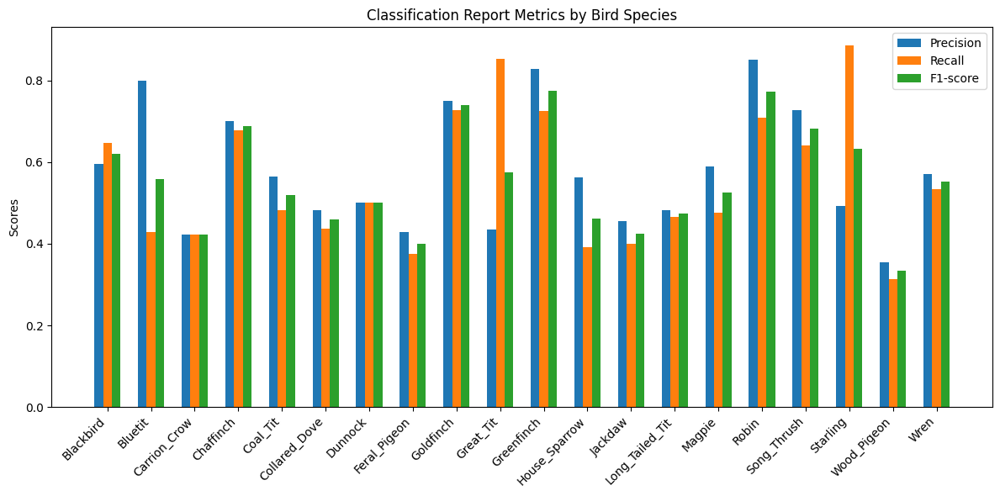

In [27]:

# Extract metrics from the classification report
report_data = classification_report(y_true, y_pred, target_names=bird_names, output_dict=True)

# Get bird names, precision, recall, and F1-score
bird_classes = list(report_data.keys())[:-3]  # Exclude 'accuracy', 'macro avg', 'weighted avg'
precision = [report_data[bird]['precision'] for bird in bird_classes]
recall = [report_data[bird]['recall'] for bird in bird_classes]
f1_score = [report_data[bird]['f1-score'] for bird in bird_classes]

# Create the bar chart
x = np.arange(len(bird_classes))  # the label locations
width = 0.2  # the width of the bars

fig, ax = plt.subplots(figsize=(12, 6))  # Adjust figure size as needed
rects1 = ax.bar(x - width, precision, width, label='Precision')
rects2 = ax.bar(x, recall, width, label='Recall')
rects3 = ax.bar(x + width, f1_score, width, label='F1-score')

# Add some text for labels, title, and custom x-axis tick labels, etc.
ax.set_ylabel('Scores')
ax.set_title('Classification Report Metrics by Bird Species')
ax.set_xticks(x)
ax.set_xticklabels(bird_classes, rotation=45, ha='right')  # Rotate x-axis labels for readability
ax.legend()

# Display the plot
plt.tight_layout()  # Adjust layout to prevent labels from overlapping
plt.show()

In [28]:
def classify_images(image_path):
  input_image = tf.keras.utils.load_img(image_path, target_size=(img_size, img_size))
  input_array = tf.keras.utils.img_to_array(input_image)
  input_image_exp_dim = tf.expand_dims(input_array, axis=0)

  predictions = model.predict(input_image_exp_dim)
  result = tf.nn.softmax(predictions[0])
  outcome = 'The image most likely belongs to {} with a {:.2f} percent confidence.'.format(bird_names[np.argmax(result)], 100 * np.max(result))
  return outcome

In [29]:
classify_images('/content/drive/MyDrive/data/bird_images_dataset/withBackground/Goldfinch/(148).jpg')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step


'The image most likely belongs to Goldfinch with a 12.50 percent confidence.'

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


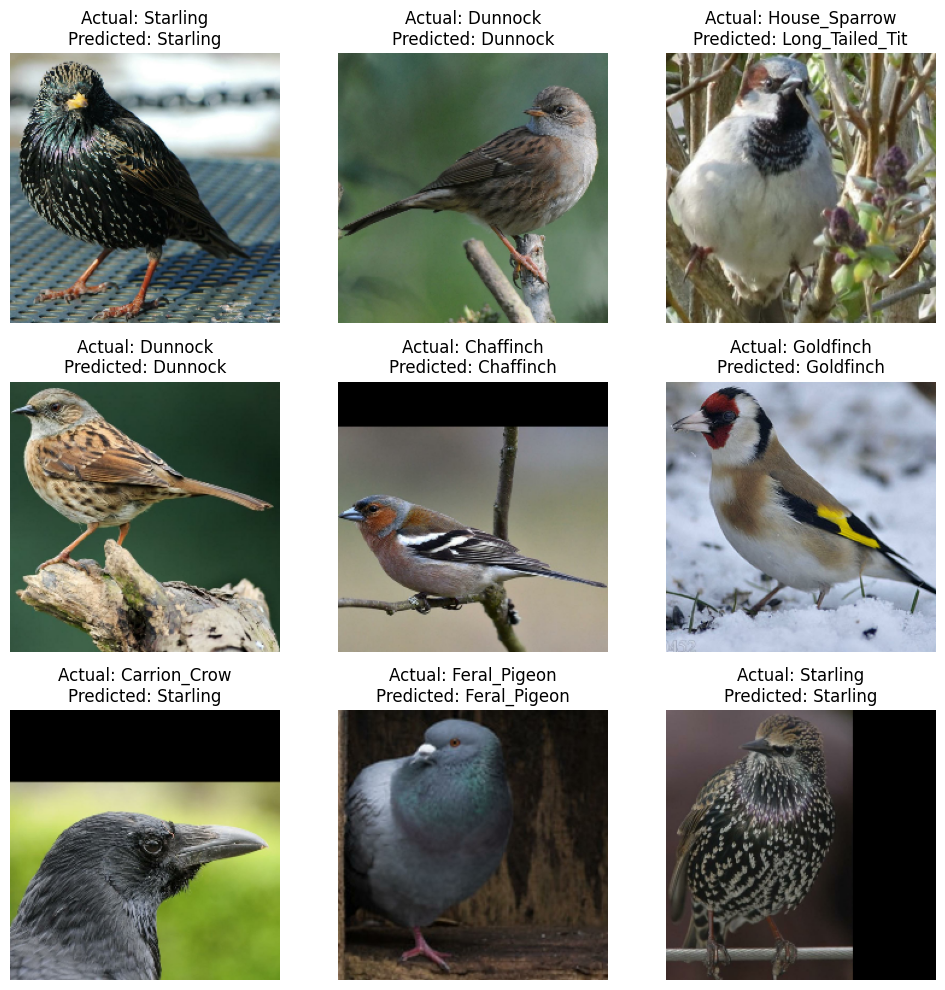

In [30]:
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np

def show_predictions(model, dataset, bird_names, num_images=9):

  plt.figure(figsize=(10, 10))

  for images, labels in dataset.take(1):
    for i in range(min(num_images, len(images))):
      ax = plt.subplot(3, 3, i + 1)  # Adjust subplot grid if num_images changes

      # Display the image
      ax.imshow(images[i].numpy().astype("uint8"))

      # Get the actual bird name
      actual_bird_name = bird_names[labels[i]]

      # Make a prediction
      img_array = tf.expand_dims(images[i], 0)  # Add batch dimension
      predictions = model.predict(img_array)
      predicted_bird_index = np.argmax(predictions)
      predicted_bird_name = bird_names[predicted_bird_index]

      # Set the title with actual and predicted names
      ax.set_title(f"Actual: {actual_bird_name}\nPredicted: {predicted_bird_name}")

      ax.axis("off")

  plt.tight_layout()  # Adjust spacing between subplots
  plt.show()

# Example usage:
show_predictions(model, val_ds, bird_names)

In [31]:
# Save the entire model
model.save('/content/drive/MyDrive/data/bird_images_dataset/honours_project_model_update_batch64.h5')  # HDF5 format

# Save in TensorFlow SavedModel format (using .keras extension)
model.save('/content/drive/MyDrive/data/bird_images_dataset/honours_project_model_update_batch64.keras')

In [32]:
# Save the entire model
model.save('/content/drive/MyDrive/data/bird_images_dataset/honours_project_model_update_batch64.h5')  # HDF5 format

# Save in TensorFlow SavedModel format (using .keras extension)
model.save('/content/drive/MyDrive/data/bird_images_dataset/honours_project_model_update_batch64.keras')

In [33]:
# ... (your model training and other code) ...

# Save the model in the recommended Keras format
model.save('/content/drive/MyDrive/data/bird_images_dataset/honours_project_model_In_Keras_update_batch64.keras')

print("Model saved in Keras format.")

Model saved in Keras format.


9/9 ━━━━━━━━━━━━━━━━━━━━ 14s 2s/step


<ipython-input-34-a0bf689aeb2c>:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=bird_names, y=accuracies, palette='viridis')  # Use a color palette


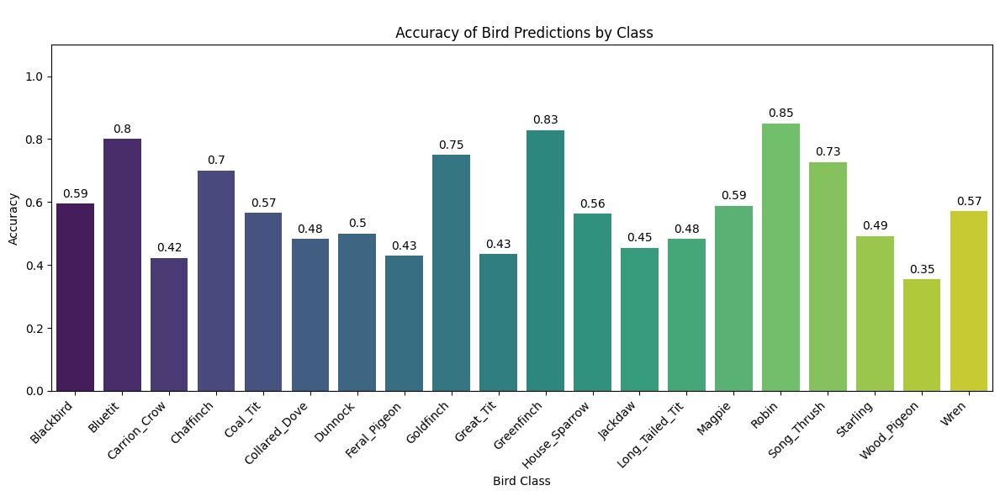

In [34]:
y_pred = model.predict(val_ds)
y_pred = np.argmax(y_pred, axis=1)  # Convert predictions to class labels

# Get true labels for the validation dataset
y_true = []
for images, labels in val_ds:
    y_true.extend(labels.numpy())

# Generate the classification report
report = classification_report(y_true, y_pred, target_names=bird_names, output_dict=True)

# Extract per-class accuracy from the report
accuracies = [report[bird]['precision'] for bird in bird_names]  # Use 'precision' for prediction accuracy

# Create the bar chart
plt.figure(figsize=(12, 6))  # Adjust figure size as needed
sns.barplot(x=bird_names, y=accuracies, palette='viridis')  # Use a color palette
plt.title('\n Accuracy of Bird Predictions by Class')
plt.xlabel('Bird Class')
plt.ylabel('Accuracy')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels if needed

# Adjust y-axis limits to accommodate the 100 value
plt.ylim(0, 1.1)  # Extend the upper limit slightly

# Add accuracy values on top of the bars
for i, v in enumerate(accuracies):
    plt.text(i, v + 0.02, str(round(v, 2)), ha='center')

plt.tight_layout()
plt.show()

In [40]:
base_dir = '/content/drive/MyDrive/data/bird_images_dataset/withBackground/'
test_ds = tf.keras.utils.image_dataset_from_directory(
       directory=base_dir,
       image_size=(img_size, img_size),
       batch_size=batch_size,
       shuffle=False  # Do not shuffle the test data
   )

Found 2841 files belonging to 20 classes.


In [44]:
def test_model(model, test_data_directory, bird_names, img_size, batch_size):
   """Tests the trained model on a separate test dataset.

   Args:
       model: The trained Keras model.
       test_data_directory: Path to the directory containing the test images.
       bird_names: List of bird class names.
       img_size: Target image size for resizing.
       batch_size: Batch size for data loading.
   """

   test_ds = tf.keras.utils.image_dataset_from_directory(
       test_data_directory,
       image_size=(img_size, img_size),
       batch_size=batch_size,
       shuffle=False
   )

   loss, accuracy = model.evaluate(test_ds)
   print("Test Loss:", loss) # Fixed indentation
   print("Test Accuracy:", accuracy) # Fixed indentation

   y_pred = model.predict(test_ds)
   y_pred = np.argmax(y_pred, axis=1)

   y_true = []
   for images, labels in test_ds:
       y_true.extend(labels.numpy())

   report = classification_report(y_true, y_pred, target_names=bird_names)
   print(report)

   # Optional: Visualize predictions
   # show_predictions(model, test_ds, bird_names)

In [46]:
y_pred = model.predict(test_ds)
y_pred = np.argmax(y_pred, axis=1)  # Convert predictions to class labels

y_true = []
for images, labels in test_ds:
    y_true.extend(labels.numpy())

report = classification_report(y_true, y_pred, target_names=bird_names)
print(report)

45/45 ━━━━━━━━━━━━━━━━━━━━ 77s 2s/step
                 precision    recall  f1-score   support

      Blackbird       0.77      0.85      0.81       150
        Bluetit       0.96      0.72      0.82       150
   Carrion_Crow       0.73      0.71      0.72       131
      Chaffinch       0.82      0.87      0.84       150
       Coal_Tit       0.89      0.75      0.81       144
  Collared_Dove       0.79      0.81      0.80       150
        Dunnock       0.76      0.71      0.74       150
   Feral_Pigeon       0.81      0.78      0.80        93
      Goldfinch       0.91      0.93      0.92       150
      Great_Tit       0.68      0.95      0.79       150
     Greenfinch       0.92      0.87      0.89       150
  House_Sparrow       0.84      0.75      0.80       150
        Jackdaw       0.78      0.69      0.73       131
Long_Tailed_Tit       0.79      0.77      0.78       150
         Magpie       0.89      0.80      0.85        92
          Robin       0.91      0.90      0.90  

In [47]:
import numpy as np
from sklearn.metrics import accuracy_score

y_pred = model.predict(test_ds)
y_pred_classes = np.argmax(y_pred, axis=1)  # Convert predictions to class labels

y_true = []
for images, labels in test_ds:
    y_true.extend(labels.numpy())

# Create a list of correct/incorrect predictions
correct_predictions = [pred == true for pred, true in zip(y_pred_classes, y_true)]

# Calculate overall accuracy
accuracy = accuracy_score(y_true, y_pred_classes)

# Print the results
print("Correct Predictions:", correct_predictions)
print("Overall Accuracy:", accuracy)

45/45 ━━━━━━━━━━━━━━━━━━━━ 101s 2s/step
Correct Predictions: [np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.False_, np.True_, np.False_, np.True_, np.True_, np.True_, np.True_, np.True_, np.False_, np.False_, np.False_, np.True_, np.True_, np.False_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.False_, np.False_, np.True_, np.False_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.False_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.False_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.False_, np.False_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.True_, np.Tr